# Capstone Project
GOAL: 
    - Retrieve the actual companies' locations and plot them to a map to find out which companies about your sector in your surroundings you have, 
    in which city you should move to for this, etc. Feel free to change these queries and places to match your needs.
    - Cluster this information per states and generate choroplets to visualize wich country region is the most suitable for you

## Procedure
Retrieving data from foursquare's API:
    - needs to pass:
        + Class Link
    - Read from external json Foursquare API:
        + Load data from cities in Germany and matching them with queries
    - Request to FouSquare API about:
        + Data Science
        + Data Mining
        + Data Analysis
- Generatation of a map popping companies' names
- Generation of clusters
- Generation of maps showing clusters (choropleths)
- Generation of statistics and graphs for visualization

In [11]:
# Imports
##########################################################################

# from pathlib import Path
from os import path

# working with json and tranforming json file into a pandas dataframe library
import json
from pandas.io.json import json_normalize

import requests # library to handle requests
import pandas as pd # library for data analsysis
import numpy as np # library to handle data in a vectorized manner
import random # library for random number generation

from geopy.geocoders import Nominatim # module to convert an address into latitude and longitude values

# libraries for displaying images
from IPython.display import Image 
from IPython.core.display import HTML 
import folium # plotting library

# plot
import matplotlib as mpl
import matplotlib.pyplot as plt

# regex
import re

print ('modules imported!')

modules imported!


In [2]:
'''
Uncomment if want to actualize cities from wikipedia (not really needed...)
'''
# url = 'https://en.wikipedia.org/wiki/List_of_cities_in_Germany_by_population'

# series_df = pd.read_html(url, encoding='utf_16')
# # series_df = pd.read_html(url)
# df = series_df[0]
# df = df.drop(labels={'2015rank', '2015estimate', 'Change', '2011census', '2015land area', '2015populationdensity'}, axis=1)

# location_columns = df['Location'].str.split(pat="/", expand=True).rename(columns={0: 'cardLocation', 1: 'dLocation'})
# location_columns2 = location_columns['dLocation'].str.split(pat="°N", expand=True)
# location_columns2 = location_columns2.rename(columns={0: 'Latitude', 1: 'Longitude'})

# try:
#     location_columns2['Latitude'] = location_columns2['Latitude'].astype(float)
#     print ('converted to float')
# except Exception as e:
#     print (e)
#     print ('Trying to decode...')
#     location_columns2['Latitude'] = location_columns2['Latitude'].str.replace(u' \ufeff', u'')
#     location_columns2['Latitude'] = location_columns2['Latitude'].astype(float)
#     print('final data type from {} is {}'.format(location_columns2['Latitude'].name, location_columns2['Latitude'].dtypes))

# try:
#     location_columns2['Longitude'] = location_columns2['Longitude'].astype(float)
#     print ('converted to float')
# except Exception as e:
#     print (e)
#     print ('Trying to decode...')
#     location_columns2['Longitude'] = location_columns2['Longitude'].str.replace(u' \ufeff', u'')
#     location_columns2['Longitude'] = location_columns2['Longitude'].str.replace(u'°E', u'')
#     location_columns2['Longitude'] = location_columns2['Longitude'].astype(float)
#     print('final data type from {} is {}'.format(location_columns2['Longitude'].name, location_columns2['Longitude'].dtypes))

# df = pd.concat([df, location_columns2], axis=1)
# df = df.drop(labels={'Location'}, axis=1)

# position = pd.DataFrame(columns={'Position'})
# my_dict = {
#     'Position': ''
# }
# for idx in df.index:
#     string = str(round(df['Latitude'].iloc[idx], ndigits=3)) + ',' + str(round(df['Longitude'].iloc[idx], ndigits=3))
#     my_dict = {
#         'Position': string
#     }
#     position = position.append(my_dict, ignore_index=True)

# df = pd.concat([df, position], axis=1)

# df.to_csv('./data/loc_cities_germany.csv')

'\nUncomment if want to actualize cities from wikipedia (not really needed...)\n'

In [3]:
# Find geocenter of Germany
geolocator = Nominatim(user_agent='aiFinder')
location = geolocator.geocode('Germany')

latGE = location.latitude           # --> Center
lonGE = location.longitude          # --> Center
locationGE = str(str(latGE) + ',' + str(lonGE))

# generate map centered on the middle of Germany:
#################################################################
mapGE = folium.Map(location=[latGE, lonGE], zoom_start=7)
choro_businessGE = folium.Map(location=[latGE, lonGE], zoom_start=7)
choro_studyGE = folium.Map(location=[latGE, lonGE], zoom_start=7)

print ('blank maps created')

blank maps created


In [7]:
# Get credentials from json file
#########################################################################
'''
NOTE: you may want to overwrite them to use yours after in the declaration and get rid of this!
'''

# Open json file and return content of it
def readFile(nameFile):
    Path = path.abspath(nameFile)
    with open(Path, 'r') as file:
        content = file.read()
        return content

def writeFile(nameFile, data):
    with open(nameFile, 'w') as file:
        file.write(data)

In [8]:
# Classes
##########################################################################
'''
class Link() -> generates a link to query the json file out of foursquare's API:
    method url_from_venue -> generates this link for venues and needs of: 
        option,         venues
        location,       as: latitud, longitud
        query           as: coffee, chinese food, windsurf...
'''
class Link:

    global main_URL, client_id, client_secret, version

    def __init__(self, **kwargs):
        self.__dict__.update(kwargs)

    def venue(self, **kwargs):
        self.option = '/' + self.option + '?'
        self.location = 'll=' + self.location
        self.query = '&query=' + self.query
        url = str(main_URL+'venues'+self.option+self.location+self.query+'&client_id='+client_id+'&client_secret='+client_secret+'&v='+version)
        # kwargs should have the same name as in Foursquare
        for key, value in kwargs.items():
            append = '&' + key + '=' + str(value)
            url = url + append
        return (url)

In [9]:
# Functions:
#################################################################
# function to avoid generating testing variables of json indenxed files (only for test):
def view_json(var):
    # r=requests.get("http://www.example.com/", headers={"content-type":"text"})
    var = requests.get(var).json()
    var = json.dumps(var, sort_keys=True, indent=2)
    return print (var)


# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']


# function to pass a link and get a request and a json data out of it
def get_df(link):
    results = requests.get(link).json()
    # print (results)
    # Pretty printing:
    json_string = json.dumps(results, sort_keys=True, indent=2)
    # print(json_string)
    # generate a python variable to access data:
    jdata = json.loads(json_string)
    jdata = jdata['response']['venues']
    # jdata = jdata['response']['groups']
    # view_json(jdata)              # object of a self-made function which prints json beautified!
    # lets import this data into pandas
    dataframe = json_normalize(jdata)
    # print (df.columns)
    # print (df.head())
    return dataframe


# keep only columns that include venue name, and anything that is associated with location
def filter_df(dataframe):
    filtered_columns = ['name', 'categories'] + [col for col in dataframe.columns if col.startswith('location.')] + ['id']
    dataframe = dataframe.loc[:, filtered_columns]  
    dataframe = dataframe.rename(columns=lambda x: re.sub('location.','',x))
    return dataframe


def readJson(path):
    with open(path, 'r') as file:
        data = json.load(file)
    return data


In [12]:
# Globals initialization
#########################################################################
# read json file and save it
'''
NOTE: comment these 4 following lines and force your keys!
'''

id_key = readFile('credentials.json')
id_key = json.loads(id_key)

# inizializate id credentials
client_id = id_key["client_id"]
client_secret = id_key["client_secret"]
version = str(20180602)

# object for URL from foursquare's API
main_URL = 'https://api.foursquare.com/v2/'

# TODO: limit the data frame 'df' to a distance with 'me' and drop the rest
#Read Dataframe from CSV
df = pd.read_csv('./data/loc_cities_germany.csv', usecols={'City', 'State', 'Latitude', 'Longitude', 'Position'})

col_use = [
    'id', 'name', 'categories', 'address', 'cc', 'city', 'country',
    'formattedAddress', 'labeledLatLngs', 'lat', 'lng', 'state',
    'postalCode']

i=0
categories = {}
cl_DSGE = pd.DataFrame()
cl_DMGE = pd.DataFrame()
cl_DAGE = pd.DataFrame()

address = ['city', 'state', 'country', 'lat', 'lng', 'postalCode']

bundeslaender_EN = [
    "Baden-Württemberg",
    "Bavaria",
    "Berlin",
    "Brandenburg",
    "Bremen",
    "Hamburg",
    "Hessen",
    "Lower Saxony",
    "Mecklenburg-Vorpommern",
    "North Rhine-Westphalia",
    "Rhineland-Palatinate",
    "Saarland",
    "Saxony",
    "Saxony-Anhalt",
    "Schleswig-Holstein",
    "Thuringia",
]

bundeslaender_DE = [
    "Baden-Württemberg",
    "Bayern",
    "Berlin",
    "Brandenburg",
    "Bremen",
    "Hamburg",
    "Hessen",
    "Niedersachsen",
    "Mecklenburg-Vorpommern",
    "Nordrhein-Westfalen",
    "Rheinland-Pfalz",
    "Saarland",
    "Sachsen",
    "Sachsen-Anhalt",
    "Schleswig-Holstein",
    "Thüringen",
]

geojson = readJson('data/test.json')
total = pd.DataFrame()    

print ('initialization from variables done!')

initialization from variables done!


## Main loop
This code is made out of a for loop which iterate items a number of times.

In it are going to be generated links for the API, data frames out its json (json response) and markers for the final map.

In between these data frames are filtered for convinience (please see filter_df and get_category_type methods above).

In [13]:

for pos in (df['Position']):

    # Generate links for different query types out of Foursquare
    datascienceGE = Link(option='search', location=pos, query='\"data science\"').venue(radius=50000,limit=80) 
    dataminingGE = Link(option='search', location=pos, query='\"data mining\"').venue(radius=50000,limit=80) 
    dataanalysisGE = Link(option='search', location=pos, query='\"data analysis\"').venue(radius=50000,limit=80) 

    try:
        # convert first to json and secondly to pandas DataFrame
        df_DSGE = get_df(datascienceGE)
        # filter the category for each row
        df_DSGE = filter_df(df_DSGE)
        df_DSGE['categories'] = df_DSGE.apply(get_category_type, axis=1)

        # drop nulls
        df_DSGE = df_DSGE[ ((df_DSGE['city'].notnull()) & (df_DSGE['state'].notnull())) ]
        
        # clusters:
        '''
            1) count values:
                + matches for every city
                + categories (need bins)
            2) get the position of this city with Nominatim
            3) save it in another dataframe (can be 'i'clustDSGE.csv)
        '''
        
        dummy = pd.get_dummies(df_DSGE['categories'])

        if cl_DSGE.empty:
            cl_DSGE = pd.concat([df_DSGE, dummy], axis=1)
        else:
            a = pd.concat([df_DSGE, dummy], axis=1)
            cl_DSGE = a.append(cl_DSGE)

        # instantiate a feature group for matches in the dataframe
        dataSci = folium.map.FeatureGroup()
        for latitude, longitude, companyname in zip(df_DSGE.lat, df_DSGE.lng, df_DSGE.name):
            dataSci.add_child(
                # Add markers to the map for every match
                folium.CircleMarker(
                    [latitude, longitude],
                    radius=7, # define how big you want the circle markers to be
                    color='yellow',
                    fill=True,
                    fill_color='red',
                    fill_opacity=0.6
                )
            )
            dataSci.add_child(
                # add simple popup with the name of the company when clicked
                folium.Marker(
                    location=[latitude, longitude],
                    icon=None,
                    popup=companyname,
                )
            )
        mapGE.add_child(dataSci)
        print ('{}: This city has {} results for data science'.format(df['City'].iloc[i], df_DSGE.shape[0]))
    except Exception as e:
        print ('E1000: {}, {}: This city has no results for data science'.format(e, df['City'].iloc[i]))
        pass

    try:
        df_DMGE = get_df(dataminingGE)

        df_DMGE = filter_df(df_DMGE)
        df_DMGE['categories'] = df_DMGE.apply(get_category_type, axis=1)

        df_DMGE = df_DMGE[ ((df_DMGE['city'].notnull()) & (df_DMGE['state'].notnull())) ]

        dummy = pd.get_dummies(df_DMGE['categories'])

        if cl_DMGE.empty:
            cl_DMGE = pd.concat([df_DMGE, dummy], axis=1)
        else:
            b = pd.concat([df_DMGE, dummy], axis=1)
            cl_DMGE = b.append(cl_DMGE)

        dataMin = folium.map.FeatureGroup()
        for latitude, longitude, companyname in zip(df_DMGE.lat, df_DMGE.lng, df_DMGE.name):
            dataMin.add_child(
                folium.CircleMarker(
                    [latitude, longitude],
                    radius=7,
                    color='yellow',
                    fill=True,
                    fill_color='green',
                    fill_opacity=0.6
                )
            )
            dataMin.add_child(
                folium.Marker(
                    location=[latitude, longitude],
                    icon=None,
                    popup=companyname,
                )
            )
        mapGE.add_child(dataMin)
        print ('{}: This city has {} results for data mining'.format(df['City'].iloc[i], df_DMGE.shape[0]))
    except Exception as e:
        print ('E1000: {}, {}: This city has no results for data mining'.format(e, df['City'].iloc[i]))
        pass

    try:
        df_DAGE = get_df(dataanalysisGE)

        df_DAGE = filter_df(df_DAGE)
        df_DAGE['categories'] = df_DAGE.apply(get_category_type, axis=1)

        df_DAGE = df_DAGE[ ((df_DAGE['city'].notnull()) & (df_DAGE['state'].notnull())) ]

        dummy = pd.get_dummies(df_DAGE['categories'])

        if cl_DAGE.empty:
            cl_DAGE = pd.concat([df_DAGE, dummy], axis=1)
        else:
            c = pd.concat([df_DAGE, dummy], axis=1)
            cl_DAGE = c.append(cl_DAGE)

        dataAna = folium.map.FeatureGroup()
        for latitude, longitude, companyname in zip(df_DAGE.lat, df_DAGE.lng, df_DAGE.name):
            dataAna.add_child(
                folium.CircleMarker(
                    [latitude, longitude],
                    radius=7,
                    color='yellow',
                    fill=True,
                    fill_color='blue',
                    fill_opacity=0.6
                )
            )
            dataAna.add_child(
                folium.Marker(
                    location=[latitude, longitude],
                    icon=None,
                    popup=companyname,
                )
            )
        mapGE.add_child(dataAna)
        print ('{}: This city has {} results for data analysis'.format(df['City'].iloc[i], df_DAGE.shape[0]))
    except Exception as e:
        print ('E1000: {}, {}: This city has no results for data analysis'.format(e, df['City'].iloc[i]))
        pass
    i+=1

Berlin: This city has 47 results for data science
Berlin: This city has 47 results for data mining
Berlin: This city has 47 results for data analysis


/usr/lib64/python3.8/site-packages/pandas/core/frame.py:7134: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return concat(


Hamburg: This city has 35 results for data science
Hamburg: This city has 25 results for data mining
Hamburg: This city has 24 results for data analysis
Munich (München): This city has 46 results for data science
Munich (München): This city has 36 results for data mining
Munich (München): This city has 37 results for data analysis
Cologne (Köln): This city has 42 results for data science
Cologne (Köln): This city has 42 results for data mining
Cologne (Köln): This city has 42 results for data analysis
Frankfurt am Main: This city has 42 results for data science
Frankfurt am Main: This city has 39 results for data mining
Frankfurt am Main: This city has 38 results for data analysis
Stuttgart: This city has 21 results for data science
Stuttgart: This city has 17 results for data mining
Stuttgart: This city has 17 results for data analysis
Düsseldorf: This city has 42 results for data science
Düsseldorf: This city has 45 results for data mining
Düsseldorf: This city has 45 results for dat

Neuss: This city has 45 results for data mining
Neuss: This city has 45 results for data analysis
Darmstadt: This city has 41 results for data science
Darmstadt: This city has 41 results for data mining
Darmstadt: This city has 40 results for data analysis
Paderborn: This city has 5 results for data science
Paderborn: This city has 4 results for data mining
Paderborn: This city has 4 results for data analysis
Regensburg: This city has 3 results for data science
Regensburg: This city has 2 results for data mining
Regensburg: This city has 2 results for data analysis
Ingolstadt: This city has 8 results for data science
Ingolstadt: This city has 6 results for data mining
Ingolstadt: This city has 6 results for data analysis
Würzburg: This city has 5 results for data science
Würzburg: This city has 5 results for data mining
Würzburg: This city has 4 results for data analysis
Fürth: This city has 15 results for data science
Fürth: This city has 11 results for data mining
Fürth: This city ha

In [14]:
# Map with companies's names when hovering on them
mapGE

In [15]:
cluster_dict = {
    'cl_DSGE': cl_DSGE,
    'cl_DMGE': cl_DMGE,
    'cl_DAGE': cl_DAGE
}
print ('declaration of list for next loop done!')

declaration of list for next loop done!


In [16]:
# clusters:
#################################################################
for idx, df in cluster_dict.items():
    # cleaning data:
    #################################################################
    
    df = df.reset_index()
    df = df[ ((df['city'].notnull()) & (df['state'].notnull())) ]
    df = df.set_index(address)

    for column in df.columns:
        if column in col_use:
            df = df.drop(column, axis=1) 

    df = df.groupby(level=['city','state'])[df.columns].sum()

    df = df.reset_index()

    # TODO: needs to filter those who are relevant for clustering!
    for idx, land in df['state'].items():
        if land in (bundeslaender_DE or bundeslaender_EN):
            pass
        else:
            df.drop(idx, inplace=True, axis=0)

    # total from clusters:
    #################################################################
    if total.empty:
        total = df
    else:
        total = total.append(df)

In [17]:
# Filtering clusters:
#################################################################

total = total.set_index('state')
total = total.drop('city', axis=1)
total = total.groupby('state')[total.columns].sum()
total = total.reset_index()

pattern11 = r'(?!college|residential)(.*)?building(.*)?'
pattern12 = r'(?!dentist|paper)(.*)?office(.*)?'
pattern13 = r'(.*)?business(.*)?'
pattern14 = r'(.*)?coworking(.*)?'
pattern15 = r'(.*)?it service(.*)?'
pattern16 = r'(.*)?professional & other places(.*)?'
pattern17 = r'(.*)?startup(.*)?'
pattern18 = r'(.*)?factory(.*)?'
pattern19 = r'(.*)?finantial(.*)?'
business_pattern = (pattern11 + '|' + pattern12 + '|' + pattern13 + '|' + pattern14 + '|' + pattern15 + '|' + pattern16 + '|' + pattern17 + '|' + pattern18)

pattern21 = r'(.*)?college(.*)?'
pattern22 = r'(.*)?academic(.*)?'
pattern23 = r'(.*)?university(.*)?'
pattern24 = r'(.*)?school(.*)?'
pattern25 = r'(.*)?research(.*)?'
pattern26 = r'(.*)?stud[y|ent](.*)?'
study_pattern = (pattern21 + '|' + pattern22 + '|' + pattern23 + '|' + pattern24 + '|' + pattern25 + '|' + pattern26)

# make a list of business items in columns:
#################################################################

business_list = []
study_list = []
for column in total.columns:
    if re.match(business_pattern, column, flags=re.IGNORECASE):
        business_list.append(column)
    if re.match(study_pattern, column, flags=re.IGNORECASE):
        study_list.append(column)
business_list.append('state')
study_list.append('state')

df_business = total[business_list].set_index('state')
df_study = total[study_list].set_index('state')

df_business['total'] = df_business.sum(axis=1)
df_business = df_business.reset_index()
df_study['total'] = df_study.sum(axis=1)
df_study = df_study.reset_index()

In [18]:
# Choropleth:
#################################################################

folium.Choropleth(
    geo_data=geojson,
    data=df_business,
    columns=['state', 'total'],
    key_on='feature.properties.display_name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Index von Office per Bundesland'
).add_to(choro_businessGE)

folium.Choropleth(
    geo_data=geojson,
    data=df_study,
    columns=['state', 'total'],
    key_on='feature.properties.display_name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Index von Lehre per Bundesland'
).add_to(choro_studyGE)

# html file creation
# mapGE.save('popupmap.html')
# choro_businessGE.save('chorobusiness.html')
# choro_studyGE.save('choroschool.html')


In [19]:
# map of businesses related with Data Science clustered by region
choro_businessGE

In [20]:
# map of schools and education centres (e.g. universities) related with Data Science clustered by region
choro_studyGE

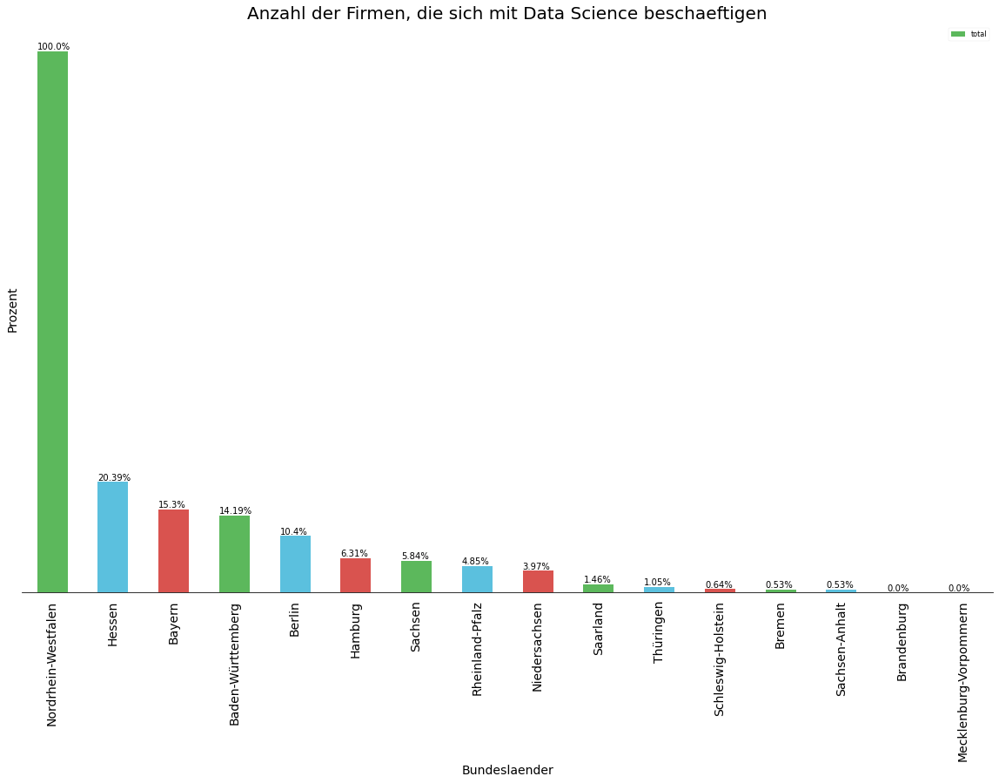

In [24]:
# plots:
#################################################################
cl_DSGE = cl_DSGE[ ((cl_DSGE['city'].notnull()) & (cl_DSGE['state'].notnull())) ]
cl_DSGE = cl_DSGE.reset_index()

plot_business = df_business[['state', 'total']].set_index('state').sort_values('total', ascending=False)
plot_study = df_study[['state', 'total']].set_index('state').sort_values('total', ascending=False)

# Style
mpl.style.use(['seaborn-paper']) 

# plot business:
#################################################################
# Initializate:
colors = tuple(['#5cb85c', '#5bc0de', '#d9534f'])
fsize = [20, 12]

ax = plot_business.plot(
    kind='bar',
    figsize=fsize,
    color=colors,
    fontsize=14, 
    # rot=30
)
# Set 
ax.set_title('Anzahl der Firmen, die sich mit Data Science beschaeftigen',fontsize=20)
ax.set_xlabel('Bundeslaender',fontsize=14)
ax.set_ylabel('Prozent', fontsize=14)
# remove axes:
ax.spines['left'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# remove ticks
ax.tick_params(
    axis='both',
    which='both',
    top=False,
    bottom=False,
    left=False,
    right=False,
    labelleft=False
)
# plot recursively values on top of bars
a=-0.25
for i, row in plot_business.iterrows(): 
    ax.annotate(
        (str( round(float(row['total']/plot_business['total'].max()*100),2))+"%"),
        xy=(a, row['total']),
        va='bottom',
        ha='left'
    )
    a=a+1

plt.show()


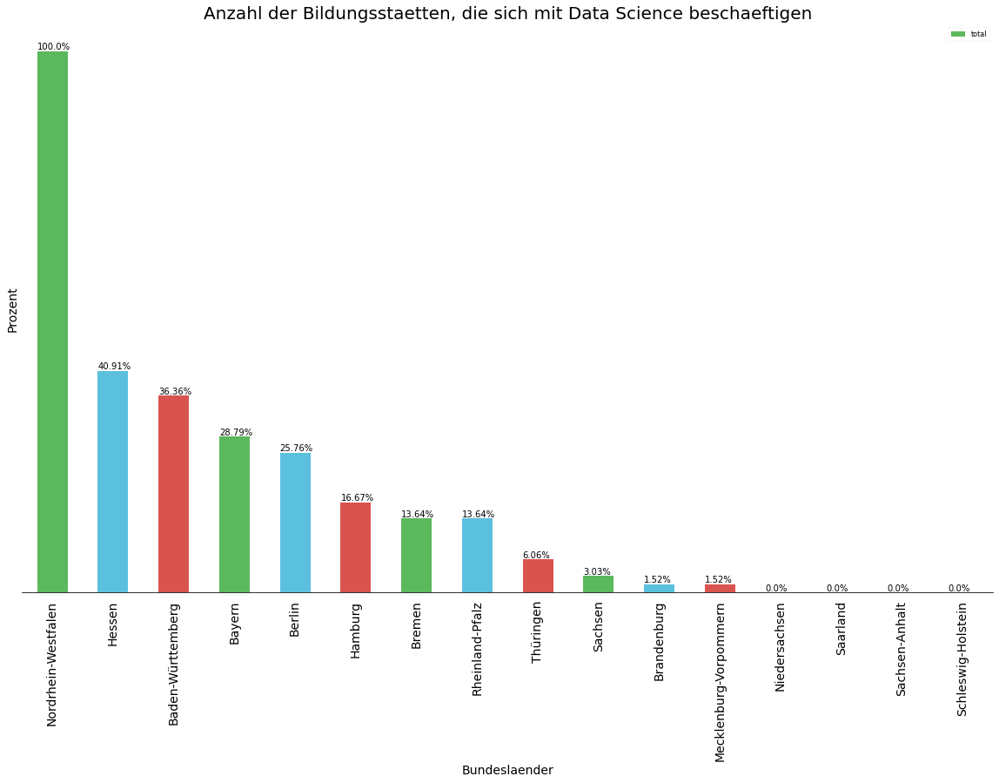

In [26]:
# plot study:
#################################################################
# Initializate:
colors = tuple(['#5cb85c', '#5bc0de', '#d9534f'])
fsize = [20, 12]

ax = plot_study.plot(
    kind='bar',
    figsize=fsize,
    color=colors,
    fontsize=14, 
    # rot=30
)
# Set 
ax.set_title('Anzahl der Bildungsstaetten, die sich mit Data Science beschaeftigen',fontsize=20)
ax.set_xlabel('Bundeslaender',fontsize=14)
ax.set_ylabel('Prozent', fontsize=14)
# remove axes:
ax.spines['left'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# remove ticks
ax.tick_params(
    axis='both',
    which='both',
    top=False,
    bottom=False,
    left=False,
    right=False,
    labelleft=False
)
# plot recursively values on top of bars
a=-0.25
for i, row in plot_study.iterrows(): 
    # print (row)
    ax.annotate(
        (str( round(float(row['total']/plot_study['total'].max()*100),2))+"%"),
        xy=(a, row['total']),
        va='bottom',
        ha='left'
    )
    a=a+1

plt.show()

Ende der Geschichte